# What drives the price of a car?

![](images/kurt.jpeg)

**OVERVIEW**

In this application, you will explore a dataset from Kaggle. The original dataset contained information on 3 million used cars. The provided dataset contains information on 426K cars to ensure speed of processing.  Your goal is to understand what factors make a car more or less expensive.  As a result of your analysis, you should provide clear recommendations to your client -- a used car dealership -- as to what consumers value in a used car.

### CRISP-DM Framework

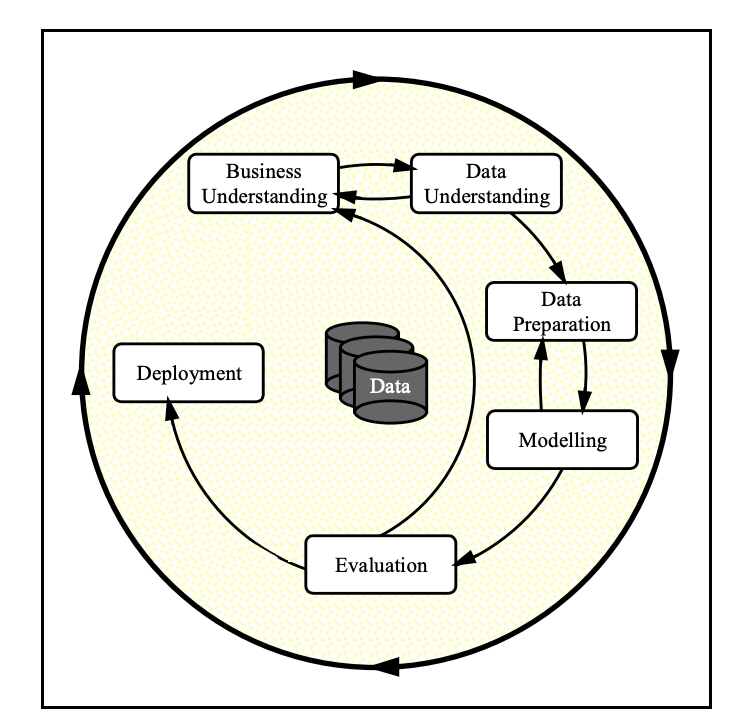

To frame the task, throughout our practical applications, we will refer back to a standard process in industry for data projects called CRISP-DM.  This process provides a framework for working through a data problem.  Your first step in this application will be to read through a brief overview of CRISP-DM [here](https://mo-pcco.s3.us-east-1.amazonaws.com/BH-PCMLAI/module_11/readings_starter.zip).  After reading the overview, answer the questions below.

### Business Understanding

From a business perspective, we are tasked with identifying key drivers for used car prices.  In the CRISP-DM overview, we are asked to convert this business framing to a data problem definition.  Using a few sentences, reframe the task as a data task with the appropriate technical vocabulary. 

1. Business Objectives: In order to run a successful used car dealership, the owner must price the used cars in a way that brings in profit. However, charging a high price for a used car is not the best way to sell used cars. The price must be reasonable enough to encourage customers to buy the used car from this dealership over other dealerships. The price must also be high enough to avoid losing profits. Determining what customers value in a used car and if those values can be used to accurately predict the price will allow the dealership to make a profit while gaining an advantage over competitors. 

2. Assess the Situation: The business question will be answered using the vehicles dataset. This dataset contains information on over 400k used cars. It should be noted that this is a reduced version of the original dataset so a setback may be that the data isn't as accurate as it would be with more information. The data will be analyzed and used to create a model using Python and other libraries in a Jupyter Notebook. 

3. Data Mining Goals: The intended output is a model that can predict the prices of used cars with as little error as possible on the validation set. 

4. Project Plan: After cleaning the data, a multiple regression model must be created to predict the price of the used cars. To determine the features that will be used in the model, sequential feature selection will be used. While training the model, the dataset will be split into two sections, the training set and the validation set. The error of the model on the test set will be calculated using the mean squared error (MSE). 

### Data Understanding

After considering the business understanding, we want to get familiar with our data.  Write down some steps that you would take to get to know the dataset and identify any quality issues within.  Take time to get to know the dataset and explore what information it contains and how this could be used to inform your business understanding.

1. Collect the Data: Import the appropriate libraries and load in the dataset

In [2]:
# Import the appropriate libraries
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import scipy.optimize
import plotly.graph_objects as go

from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import StandardScaler
from sklearn import linear_model
from sklearn.metrics import mean_squared_error
from sklearn.utils import shuffle
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge

In [3]:
# Load the data
cars = pd.read_csv('data/vehicles.csv')

2. Describe the Data: This dataset has 426k columns and 18 rows. These rows include attributes about the used cars. The features are id, region, price, year, manufacturer, model, condition, cylinders, fuel, odometer, title status, transmission, VIN, drive, size, type, paint color, and state. 

In [687]:
# Sample the first 5 rows of data
cars.head()

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
0,7222695916,prescott,6000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,az
1,7218891961,fayetteville,11900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ar
2,7221797935,florida keys,21000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,fl
3,7222270760,worcester / central MA,1500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ma
4,7210384030,greensboro,4900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nc


3. Explore the Data: There are features that are likely to affect the price of a used car more than others. For example, the VIN number has no effect on the price of a car as it is only an identification number. The same can be said about the id column as it is simply just a way to identify the transaction for the car. Features like year, odometer, and condition are likely to have more of an effect on the price. A heatmap of the correlation between the numeric features (price, year, and odometer) shows that the odometer has more of a correlation to the price than the year does. This is because the odometer-to-price correlation is 0.01 and the year-to-price correlation is -0.0049. The odometer correlation is closer to 1 than the year correlation is to -1.

In [634]:
# Find the correlation between the numeric datapoints 
cars.corr(numeric_only=True)

,id,price,year,odometer
id,1.000000,-0.002779,-0.059040,0.010721
price,-0.002779,1.000000,-0.004925,0.010032
year,-0.059040,-0.004925,1.000000,-0.157215
odometer,0.010721,0.010032,-0.157215,1.000000


Text(0.5, 1.0, 'Correlation of Numeric Features')

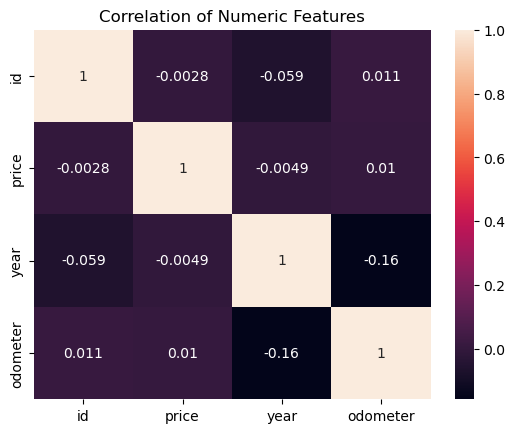

In [4]:
# Create a heatmap of the correlation between numeric features
sns.heatmap(data=cars.corr(numeric_only=True), annot=True)
plt.title('Correlation of Numeric Features')

4. Verify data quality: The data isn't very clean and will need data cleaning. There are a lot of missing data points that will need to be either deleted or filled with the column mode during data cleaning. There are also columns that can be deleted as they have no impact on the price of the car, like the VIN. There are also a few outliers, like significantly high prices and mileage, that must be dealt with. 

In [636]:
# Check/count the missing data
missing_data = cars.isnull().sum()
missing_data

id                   0
region               0
price                0
year              1205
manufacturer     17646
model             5277
condition       174104
cylinders       177678
fuel              3013
odometer          4400
title_status      8242
transmission      2556
VIN             161042
drive           130567
size            306361
type             92858
paint_color     130203
state                0
dtype: int64

In [637]:
# Check/count the percentages of missing data
missing_percent = cars.isnull().sum()/cars.shape[0]*100
missing_percent

id               0.000000
region           0.000000
price            0.000000
year             0.282281
manufacturer     4.133714
model            1.236179
condition       40.785232
cylinders       41.622470
fuel             0.705819
odometer         1.030735
title_status     1.930753
transmission     0.598763
VIN             37.725356
drive           30.586347
size            71.767476
type            21.752717
paint_color     30.501078
state            0.000000
dtype: float64

In [638]:
# Describe the data
cars.describe()

,id,price,year,odometer
count,4.268800e+05,4.268800e+05,425675.000000,4.224800e+05
mean,7.311487e+09,7.519903e+04,2011.235191,9.804333e+04
std,4.473170e+06,1.218228e+07,9.452120,2.138815e+05
min,7.207408e+09,0.000000e+00,1900.000000,0.000000e+00
25%,7.308143e+09,5.900000e+03,2008.000000,3.770400e+04
50%,7.312621e+09,1.395000e+04,2013.000000,8.554800e+04
75%,7.315254e+09,2.648575e+04,2017.000000,1.335425e+05
max,7.317101e+09,3.736929e+09,2022.000000,1.000000e+07


### Data Preparation

After our initial exploration and fine-tuning of the business understanding, it is time to construct our final dataset prior to modeling.  Here, we want to make sure to handle any integrity issues and cleaning, the engineering of new features, any transformations that we believe should happen (scaling, logarithms, normalization, etc.), and general preparation for modeling with `sklearn`. 

Data Cleaning: Drop the "id", "model", "VIN", and "size" columns. The "id" and "VIN" columns have no effect on the price. The "model" column is filled with too many inconsistent values that may be a result of poor data collected like "ALL MAKES" and "2010 AND NEWER". Over half of the "size" column was filled with null values, specifically 71.77% of the column. Next, set the minimum and maximum values of the "price" and "odometer" columns to limit outliers based on industry knowledge. Then, fill in the remaining missing data with the mode of that column. Lastly, reset the index to end with a cleaner dataset.

In [639]:
# Drop the id, model, VIN, size columns
cars.drop(columns=['id', 'model', 'VIN', 'size'], axis=1, inplace=True)

In [640]:
# Drop outliers in the price column by setiing a min and max
cars = cars[(cars['price'] < 70000) & (cars['price'] > 100)]

In [641]:
# Drop outliers in the odometer column by setiing a max
cars= cars[(cars['odometer'] < 200000)]

In [642]:
# Fill in remaining missing data with the column mode
cars.fillna(cars.mode().iloc[0], inplace=True)

In [643]:
# Reset the index
cars = cars.reset_index(drop=True)
cars

,region,price,year,manufacturer,condition,cylinders,fuel,odometer,title_status,transmission,drive,type,paint_color,state
0,auburn,33590,2014.0,gmc,good,8 cylinders,gas,57923.0,clean,other,4wd,pickup,white,al
1,auburn,22590,2010.0,chevrolet,good,8 cylinders,gas,71229.0,clean,other,4wd,pickup,blue,al
2,auburn,39590,2020.0,chevrolet,good,8 cylinders,gas,19160.0,clean,other,4wd,pickup,red,al
3,auburn,30990,2017.0,toyota,good,8 cylinders,gas,41124.0,clean,other,4wd,pickup,red,al
4,auburn,15000,2013.0,ford,excellent,6 cylinders,gas,128000.0,clean,automatic,rwd,truck,black,al
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
361348,wyoming,23590,2019.0,nissan,good,6 cylinders,gas,32226.0,clean,other,fwd,sedan,white,wy
361349,wyoming,30590,2020.0,volvo,good,6 cylinders,gas,12029.0,clean,other,fwd,sedan,red,wy
361350,wyoming,34990,2020.0,cadillac,good,6 cylinders,diesel,4174.0,clean,other,4wd,hatchback,white,wy
361351,wyoming,28990,2018.0,lexus,good,6 cylinders,gas,30112.0,clean,other,fwd,sedan,silver,wy


### Modeling

With your (almost?) final dataset in hand, it is now time to build some models.  Here, you should build a number of different regression models with the price as the target.  In building your models, you should explore different parameters and be sure to cross-validate your findings.

I will do the hot encoding for the categorical feature I wish to use later so that I may then split the data. Hot encoding must be done before splitting the data. 

In [644]:
# Use hot encoding to turn the condition nonnumeric feature into numeric values
dummies = pd.get_dummies(cars["condition"])

In [645]:
# Add the dummies to the cars DataFrame
cars_w_dummies = pd.concat([cars, dummies], axis=1)

In [646]:
# Delete the nonnumerical columns
del cars_w_dummies["region"]
del cars_w_dummies["manufacturer"]
del cars_w_dummies["condition"]
del cars_w_dummies["cylinders"]
del cars_w_dummies["fuel"]
del cars_w_dummies["title_status"]
del cars_w_dummies["transmission"]
del cars_w_dummies["drive"]
del cars_w_dummies["type"]
del cars_w_dummies["paint_color"]
del cars_w_dummies["state"]

In [689]:
# Sample the first 5 rows of the cleaned data with dummies
cars_w_dummies.head()

,price,year,odometer,excellent,fair,good,like new,new,salvage
0,33590,2014.0,57923.0,False,False,True,False,False,False
1,22590,2010.0,71229.0,False,False,True,False,False,False
2,39590,2020.0,19160.0,False,False,True,False,False,False
3,30990,2017.0,41124.0,False,False,True,False,False,False
4,15000,2013.0,128000.0,True,False,False,False,False,False


In [647]:
# Shuffle the data and split it into the training set, validation set, and test set
train_set, dev_set = np.split(shuffle(cars_w_dummies), [60])
train_set.head()

/opt/anaconda3/lib/python3.12/site-packages/numpy/core/fromnumeric.py:59: FutureWarning:

'DataFrame.swapaxes' is deprecated and will be removed in a future version. Please use 'DataFrame.transpose' instead.



,price,year,odometer,excellent,fair,good,like new,new,salvage
19602,11900,2012.0,106600.0,True,False,False,False,False,False
203638,31998,2012.0,26845.0,False,False,True,False,False,False
54303,11950,2018.0,40727.0,True,False,False,False,False,False
2385,17900,2012.0,161000.0,False,False,True,False,False,False
289370,24590,2014.0,60987.0,False,False,True,False,False,False


## Simple Linear Regression
This model will use one feature, specifically the numerical feature that is most correlated to price (odometer)

In [648]:
# Fit the model using the most correlated numeric feature (odometer)
features1 = train_set[["odometer"]]
price = train_set["price"]

c_model_1 = linear_model.LinearRegression(fit_intercept = False)
c_model_1.fit(features1, price)

LinearRegression(fit_intercept=False)

In [649]:
# Use the c_model_1 to make predictions using the data from the dev_set
c_pred_1 = c_model_1.predict(dev_set[["odometer"]])

In [650]:
# Calculate the MSE for c_model_1
mean_squared_error(c_pred_1, dev_set["price"])

427469852.9022362

In [690]:
# Plot the predictions and reality
fig = go.Figure()
fig.add_trace(go.Scatter(x=dev_set["odometer"], y=dev_set["price"],
                         mode = "markers", name = "actual"))
fig.add_trace(go.Scatter(x=dev_set["odometer"], y=c_pred_1,
                         mode = "lines", name = "predicted"))
fig.update_layout(font_size = 15)
fig.update_layout(title="Actual vs Predicted Data for Simple Linear Regression")

## Multiple Linear Regression Model (2 Features)
This model will use the two numeric features (year and odometer)

In [652]:
# Fit the model using the two numeric features that aren't price (year and odometer)
features2 = train_set[["year", "odometer"]]
price = train_set["price"]

c_model_2 = linear_model.LinearRegression(fit_intercept = False)
c_model_2.fit(features2, price)

LinearRegression(fit_intercept=False)

In [653]:
# Use the c_model_2 to make predictions using the data from the dev_set
c_pred_2 = c_model_2.predict(dev_set[["year", "odometer"]])

In [654]:
# Calculate the MSE for c_model_2
mean_squared_error(c_pred_2, dev_set["price"])

136340161.13806883

Text(0.5, 1.0, 'Actual and Predicted Data with Multiple Regression Model (2 Features)')

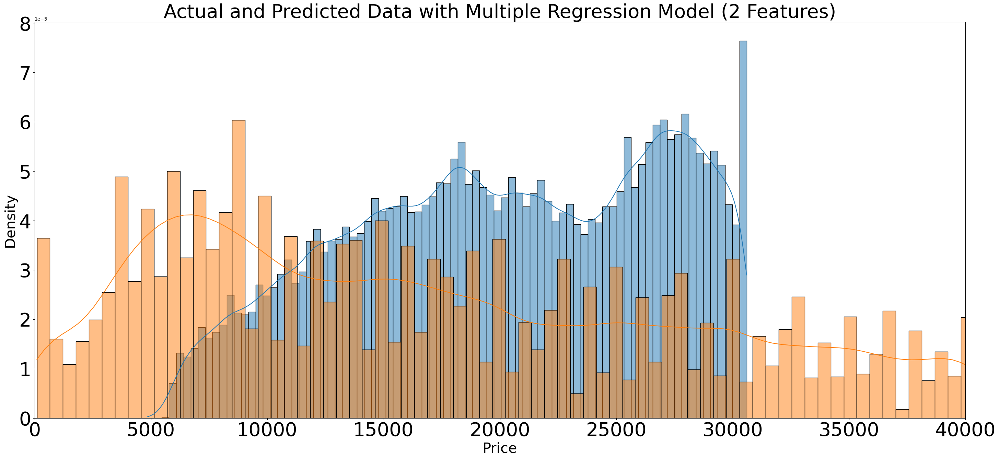

In [655]:
# Plot the predictions and reality
figure = plt.figure(figsize=(35, 15))
sns.histplot(c_pred_2, kde=True, stat="density")
sns.histplot(dev_set["price"], kde=True, stat="density")
plt.xticks(fontsize=40)
plt.yticks(fontsize=40)
plt.xlabel('Price', fontsize=30)
plt.ylabel('Density', fontsize=30)
plt.xlim(0,40000)
plt.title('Actual and Predicted Data with Multiple Regression Model (2 Features)', fontsize=40)

## Multiple Linear Regression Model (3 Features)
This model will use the two numeric features (year and odometer) and one nonnumeric feature (condition)

In [656]:
# Fit the next model uwith the two numeric features and the "condition" dummy features 
features3 = train_set[["year", "odometer", "excellent", "good", "fair", "like new", "new", "salvage"]]
price = train_set["price"]

c_model_3 = linear_model.LinearRegression(fit_intercept = False)
c_model_3.fit(features3, price)

LinearRegression(fit_intercept=False)

In [657]:
# Use c_model_3 to make predictions using the data from the dev_set
c_pred_3 = c_model_3.predict(dev_set[["year", "odometer", "excellent", "good", "fair", "like new", "new", "salvage"]])

In [658]:
# Calculate the MSE for c_model_3
mean_squared_error(c_pred_3, dev_set["price"])

10330032087.24176

Text(0.5, 1.0, 'Actual and Predicted Data with Multiple Regression Model (3 Features)')

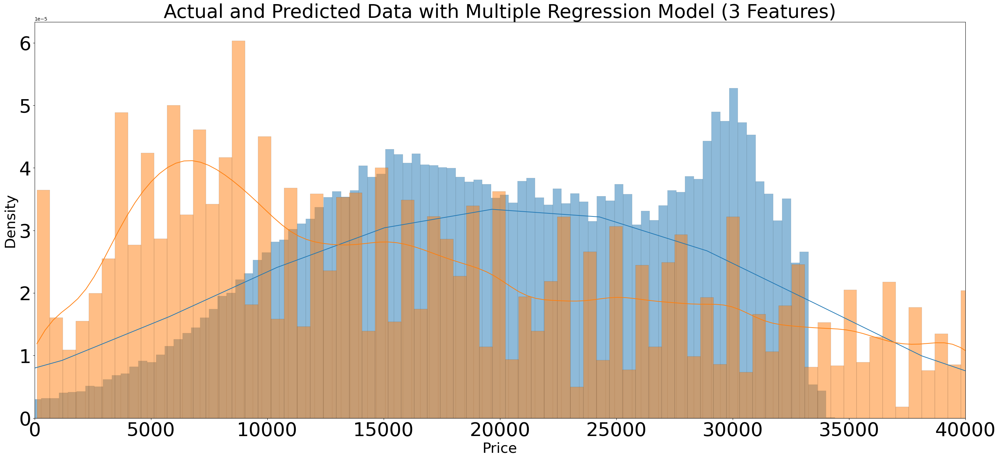

In [659]:
# Plot the predictions and reality
figure = plt.figure(figsize=(35, 15))
sns.histplot(c_pred_3, kde=True, stat="density")
sns.histplot(dev_set["price"], kde=True, stat="density")
plt.xticks(fontsize=40)
plt.yticks(fontsize=40)
plt.xlabel('Price', fontsize=30)
plt.ylabel('Density', fontsize=30)
plt.xlim(0,40000)
plt.title('Actual and Predicted Data with Multiple Regression Model (3 Features)', fontsize=40)

## LASSO Regression on Polynomial Features (Degree 2)
This model will use the two numeric features (year and odometer)

In [660]:
# Create the Polynomial Features for both the train and dev sets
poly_transform = PolynomialFeatures(degree = 2, include_bias = False)
train_squared = \
    pd.DataFrame(poly_transform.fit_transform(train_set[["year", "odometer"]]),
    columns = poly_transform.get_feature_names_out())
dev_squared = \
    pd.DataFrame(poly_transform.fit_transform(dev_set[["year", "odometer"]]),
    columns = poly_transform.get_feature_names_out())

In [661]:
# Sample the first 5 rows of the squared train_set
train_squared.head()

,year,odometer,year^2,year odometer,odometer^2
0,2012.0,106600.0,4048144.0,214479200.0,1.136356e+10
1,2012.0,26845.0,4048144.0,54012140.0,7.206540e+08
2,2018.0,40727.0,4072324.0,82187086.0,1.658689e+09
3,2012.0,161000.0,4048144.0,323932000.0,2.592100e+10
4,2014.0,60987.0,4056196.0,122827818.0,3.719414e+09


In [662]:
# Create and fit the LASSO regression model
features4 = train_squared[["year", "odometer", "year^2", "year odometer", "odometer^2"]]
price = train_set["price"]

lasso_model = Lasso(alpha=1)
lasso_model.fit(features4, price)

/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.206e+09, tolerance: 9.024e+05



Lasso(alpha=1)

In [663]:
# Use the lasso_model to make predictions using the data from the dev_set
lasso_pred = lasso_model.predict(dev_squared[["year", "odometer", "year^2", "year odometer", "odometer^2"]])

In [664]:
# Calculate the MSE for the lasso_model
mean_squared_error(lasso_pred, dev_set["price"])

131124884.60776417

Text(0.5, 1.0, 'Actual and Predicted Data with LASSO Regression')

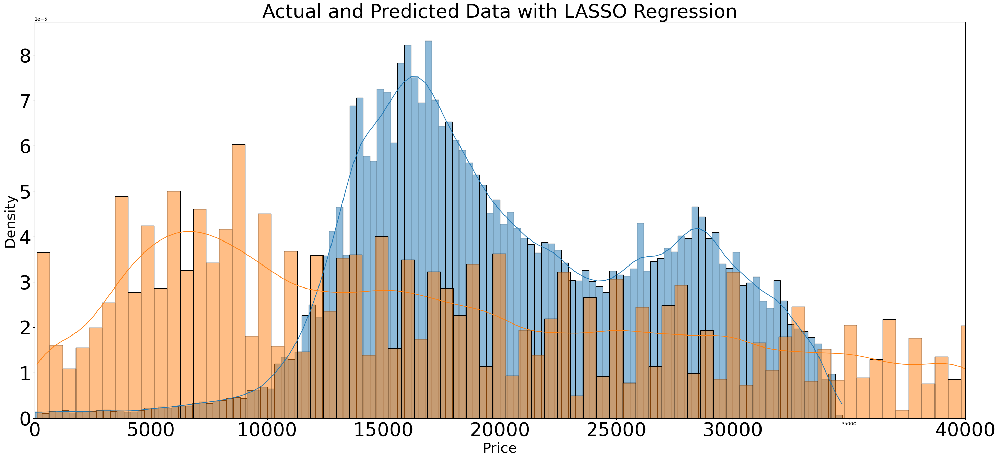

In [671]:

# Plot the predictions and reality
figure = plt.figure(figsize=(35, 15))
sns.histplot(lasso_pred, kde=True, stat="density")
sns.histplot(dev_set["price"], kde=True, stat="density")
plt.xticks(fontsize=40)
plt.yticks(fontsize=40)
plt.xlabel('Price', fontsize=30)
plt.ylabel('Density', fontsize=30)
plt.xlim(0,40000)
plt.title('Actual and Predicted Data with LASSO Regression', fontsize=40)

## Ridge Regression on Polynomial Features (Degree 3) Using GridSearchCV
This model will use the two numeric features (year and odometer)

In [665]:
# Create the Pipeline for the Ridge model
pipeline_ridge = Pipeline([
        ('cars_transform', PolynomialFeatures(degree=3, include_bias=False)),
        ('scaler', StandardScaler()),
        ('cars_regression', Ridge())
        ])

In [666]:
# Set the parameters and create the GridSearchCV object
params_to_try = {'cars_regression__alpha':[1,10,100,1000]}

model_finder = GridSearchCV(pipeline_ridge, param_grid=params_to_try)

In [667]:
# Fit the GridSearchCV object
numeric_features = cars_w_dummies[["year", "odometer"]]
model_finder.fit(numeric_features, cars_w_dummies["price"])

GridSearchCV(estimator=Pipeline(steps=[('cars_transform',
                                        PolynomialFeatures(degree=3,
                                                           include_bias=False)),
                                       ('scaler', StandardScaler()),
                                       ('cars_regression', Ridge())]),
             param_grid={'cars_regression__alpha': [1, 10, 100, 1000]})

In [668]:
# Find the best model
best_model = model_finder.best_estimator_
best_model

Pipeline(steps=[('cars_transform',
                 PolynomialFeatures(degree=3, include_bias=False)),
                ('scaler', StandardScaler()),
                ('cars_regression', Ridge(alpha=1))])

In [669]:
# Cross-Validate
model_finder.cv_results_

{'mean_fit_time': array([0.0600306 , 0.06902819, 0.07309227, 0.07160597]),
 'std_fit_time': array([0.00396239, 0.00622465, 0.01408541, 0.00538122]),
 'mean_score_time': array([0.00824823, 0.00852723, 0.00898619, 0.00892467]),
 'std_score_time': array([0.00278389, 0.00152119, 0.00079807, 0.00247889]),
 'param_cars_regression__alpha': masked_array(data=[1, 10, 100, 1000],
              mask=[False, False, False, False],
        fill_value='?',
             dtype=object),
 'params': [{'cars_regression__alpha': 1},
  {'cars_regression__alpha': 10},
  {'cars_regression__alpha': 100},
  {'cars_regression__alpha': 1000}],
 'split0_test_score': array([0.34202613, 0.33935288, 0.31481512, 0.30084371]),
 'split1_test_score': array([0.37697261, 0.36775802, 0.33798856, 0.3253452 ]),
 'split2_test_score': array([0.41551169, 0.40905345, 0.38187525, 0.36940513]),
 'split3_test_score': array([0.36370916, 0.36085959, 0.33685309, 0.32496053]),
 'split4_test_score': array([0.34585366, 0.33477142, 0.301889

### Evaluation

With some modeling accomplished, we aim to reflect on what we identify as a high-quality model and what we are able to learn from this.  We should review our business objective and explore how well we can provide meaningful insight into drivers of used car prices.  Your goal now is to distill your findings and determine whether the earlier phases need revisitation and adjustment or if you have information of value to bring back to your client.

Modeling was slightly difficult as performing hot encoding (creating numerical features for nonnumerical data) on all the nonnumerical features would have resulted in too large of a dataset to create models with. This meant that I had to choose a nonnumerical feature to turn into numerical data based on my industry knowledge. Nevertheless, various models were made, including a linear regression model, two multiple linear regression models, a LASSO regression model on polynomial features (degree 2), and a Ridge regression model on polynomial features (degree 3) using GridSearchCV. 

The best model seems to be the multiple linear regression model with three features (year, odometer, and condition). This is because this model had the overall lowest MSE at 10330032087.24176. This model seems to have enough features to avoid overfitting (a model that memorizes and matches the data too closely) and underfitting (a model that does not match the data enough to preform well).

The linear model had a high MSE which makes sense as using one feature for such a complex situation falls victim to underfitting. It should be noted that the multiple linear regression model with two features had a better MSE but not as good as the one with three features. This is likely because numerical features are not the only factors that affect the price of a car. The LASSO regression (L1 Regularization) and Ridge Regression (L2 Regularization) models also did not do as well. This could be because these models were done solely on the numerical features which could have caused underfitting. 

Features like the year, odometer, and condition of the car have an effect on the price of a car. These features should be used by the used car dealership to set prices that not only bring in profit but encourage customers to choose this dealership over others. The model can be used to predict accurate prices.

Additional information could be gathered. For starters, the original dataset should have fewer null data points. This way, the data will be more accurate and columns, like "size", will not have to be deleted. The data should also be collected carefully to avoid mistakes, like "ALL MAKES" in the "model" section. Further modeling could be done with other nonnumerical features, however, this will be more computationally expensive with hot encoding.

In [674]:
# Calculate the coefficents of the linear regression model
c_model_1.coef_

array([0.17701828])

In [675]:
# Calculate the coefficents of the multiple linear regression model with 2 features
c_model_2.coef_

array([15.13289445, -0.12240721])

In [676]:
# Calculate the coefficents of the multiple linear regression model with 3 features
c_model_3.coef_

array([ 4.39434655e+02, -9.48525072e-02, -8.59200678e+05, -8.54373322e+05,
        0.00000000e+00, -8.68333325e+05, -8.60921881e+05,  0.00000000e+00])

In [677]:
# Calculate the coefficents of the LASSO regression model of Polynomial Features (degree 2)
lasso_model.coef_

array([-3.09809624e+02, -2.60401959e-01,  1.76466886e-01,  3.58211479e-05,
        5.87753941e-07])

### Deployment

Now that we've settled on our models and findings, it is time to deliver the information to the client.  You should organize your work as a basic report that details your primary findings.  Keep in mind that your audience is a group of used car dealers interested in fine-tuning their inventory.

After extensively altering the data in a way that allowed for easier analysis and modeling, the best model was found. This model should predict the price based on the used car's year, odometer, and condition as they significantly affect the price of the used car. Based on the correlation to the price, the order of importance can be found. The odometer seems to be the most important with the price being the next in importance. When it comes down to the specific condition, customers seem to prefer a "good" used car over other conditions. Therefore, a used car with a high price should have fewer miles, be newer, and be in good condition. Although all the features in the dataset affect the price in some way (aside from the id and VIN), not all the features should be used when predicting price. Using the most important features allows accuracy and flexibility. Finding a good balance between numerical and nonnumerical features is important. So far, using the odometer, year, and condition features seems to be the "best" balance. For now, pricing can be predicted based on odometer, year, and condition. Variety in these features will result in varying prices. When it comes to inventory, the dealership should focus on buying cars that don't have too many miles, are fairly new (in terms of year), and are in good condition. Used cars that fall within this criterion are likely to be reasonably priced for customers and profitable for the dealership. These cars may even be able to be sold at slightly higher prices than predicted considering car prices are negotiable and this criterion is what customers look for most in a used car. Used cars that fall too far above or below this criterion may result in cars priced too low for the dealership to make a profit or too high for customers to afford. Accurate pricing is important as it encourages customers to choose this dealership over other dealerships; therefore, prices must be competitive yet profitable.

In [679]:
# Final clean dataset with dummies
cars_w_dummies.head()

,price,year,odometer,excellent,fair,good,like new,new,salvage
0,33590,2014.0,57923.0,False,False,True,False,False,False
1,22590,2010.0,71229.0,False,False,True,False,False,False
2,39590,2020.0,19160.0,False,False,True,False,False,False
3,30990,2017.0,41124.0,False,False,True,False,False,False
4,15000,2013.0,128000.0,True,False,False,False,False,False


Text(0.5, 1.0, 'Correlation of Features in Final Dataset')

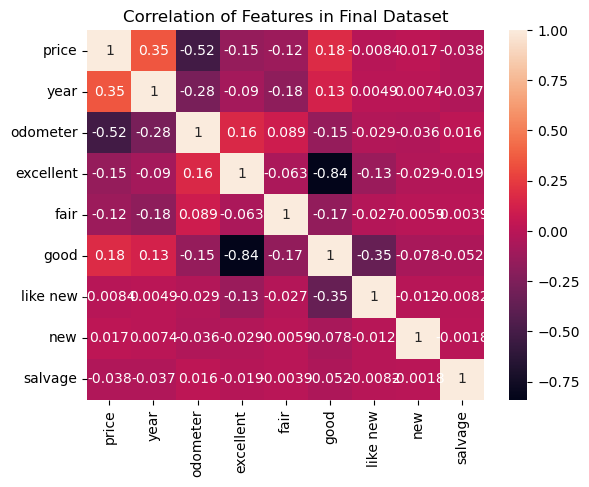

In [684]:
# Visualize the correlation of the features in the final dataset
sns.heatmap(data=cars_w_dummies.corr(numeric_only=True), annot=True)
plt.title('Correlation of Features in Final Dataset')